## PREPARATION

#### 0. Change directory

In [1]:
# Reference: https://stackoverflow.com/questions/15514593/importerror-no-module-named-when-trying-to-run-python-script/15622021#15622021
# Here choosing the folder that stores all the analysing modules
import sys
sys.path.append(r'S:\\Grid_Orientation_code_006_machine_C002AU\\LISFLOOD_FP\\Analysis')

#### 1. Packages

In [2]:
from folder import *

# Packages for generating random angle, x, and y values
from randomisation import random_values_generation

# Packages for flowdepth values extraction
from depthValue import *

# Packages for impact calculation
from impactCalculation import water_raster_nobackground, watermap_onepolygon_parallelism

# Packages for variation calculation
from statisticCalculation import calculation_dict

# Packages for plotting map
from statisticPlot import map_plotting_elev, map_plotting_wd, map_plotting_wse, area_building_plotting, area_plotting_only, building_plotting_only
import statisticPlot
import matplotlib.pyplot as plt

# For raster/polygon manipulation
import rioxarray as rxr
import geopandas as gpd
import pandas as pd

# For flood threshold plotting
from floodThreshold import flood_rate_comparison, flood_rate_plotting

#### 2. Data preparation

In [3]:
# Resolution
# resolution = 20
resolution = 10
# resolution = 5
# resolution = 2

# Time to extract flowdepth (for flowdepth_extraction() function)
extract_wse = "out.mxe"
extract_wd = 'out.max'
extract_elev = 'elev'

# Flood rate
flood_rate = 0.1

# Building path
building_path = fr"S:\new_versions\data\buildings\lds-nz-building-outlines-all-sources-SHP_002.zip"
building_data = gpd.read_file(building_path)

# Terrain path 
terrain_data = rxr.open_rasterio(fr"{original_lidar_path}\\shading\\terrain_shading.tiff")

---------------------------------------------------------------------------------------------------------------------------

#### 3. Generate csv files

In [ ]:
# %%time
# df_wse = get_water_parallelism(30, extract_wse)

In [ ]:
# %%time
# df_wd = get_water_parallelism(30, extract_wd)

In [ ]:
# %%time
# df_elev = get_water_parallelism(5, extract_elev)

-------------------------------------------------------

## ELEVATION

In [ ]:
# # If csv file was generated, use the code below to direct to the folder storing that csv file
# df_elev = pd.read_csv(fr"S:\new_versions_008_forpublication_onlyfloodevents\\vers001\\5_analysis\\elev\\untransformed_csv\\all_simulations.csv")

In [ ]:
# %%time
# statistic_dict_elev = calculation_dict(
#     df_elev, resolution,
#     building_path,
#     flood_rate,
#     extract_elev, -9999,
#     True
# )

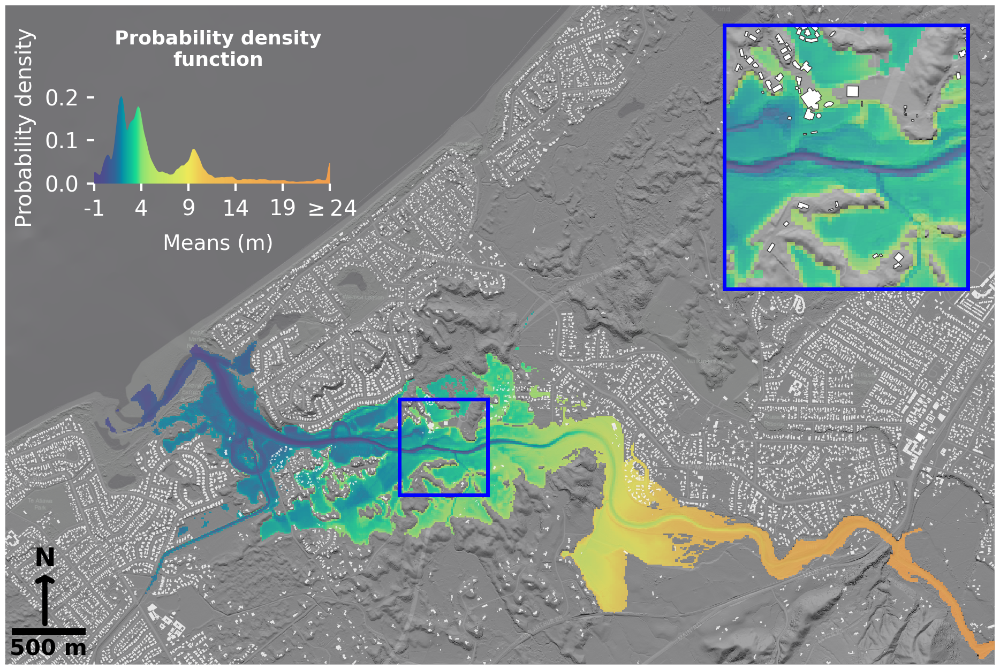

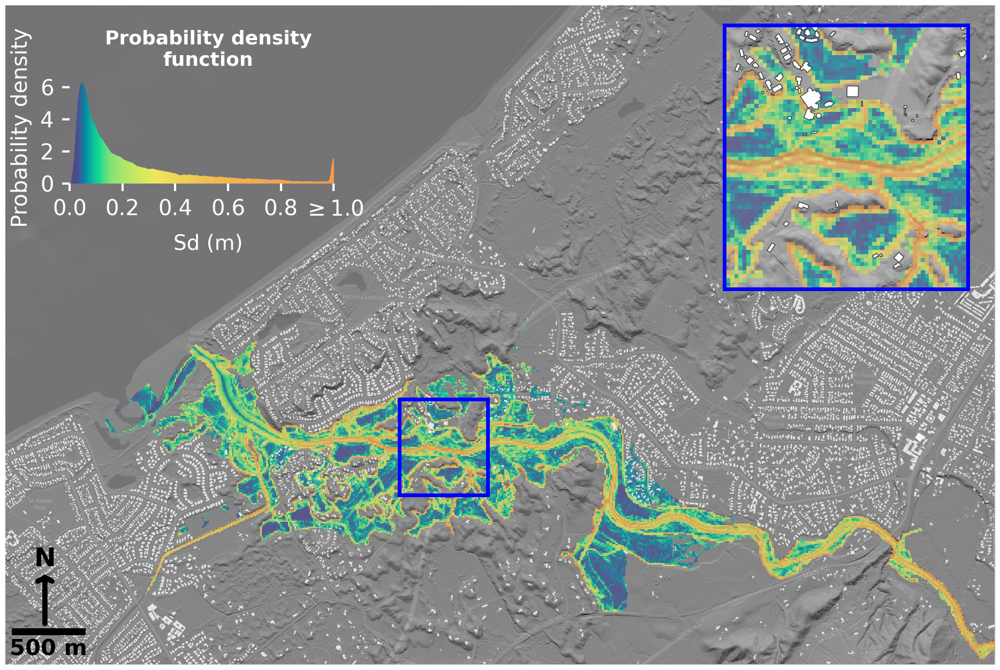

CPU times: total: 1min 31s
Wall time: 1min 31s


In [9]:
%%time
map_plotting_elev(
    ['mean', 'sd'],
    building_data,
    terrain_data,
    extract_elev
)

-----------------------------------------------------------------------

## WATER SURFACE ELEVATION

##### 4.1. CSV generation

In [ ]:
# # If csv file was generated, use the code below to direct to the folder storing that csv file
# df_wse = pd.read_csv(fr"S:\new_versions_008_forpublication_onlyfloodevents\\vers001\\5_analysis\\wse\\untransformed_csv\\all_simulations.csv")

##### 4.2. Impact calculation

In [ ]:
# %%time
# water_raster_nobackground(df_wse, flood_rate, extract_wse)

In [ ]:
# %%time
# watermap_onepolygon_parallelism(df_wse, flood_rate, 30, extract_wse)

##### 4.3. Variation calculation

In [ ]:
# %%time
# statistic_dict_wse = calculation_dict(
#     df_wse, resolution,
#     building_path,
#     flood_rate,
#     extract_wse, -9999,
#     True
# )

##### 4.4. Map plotting

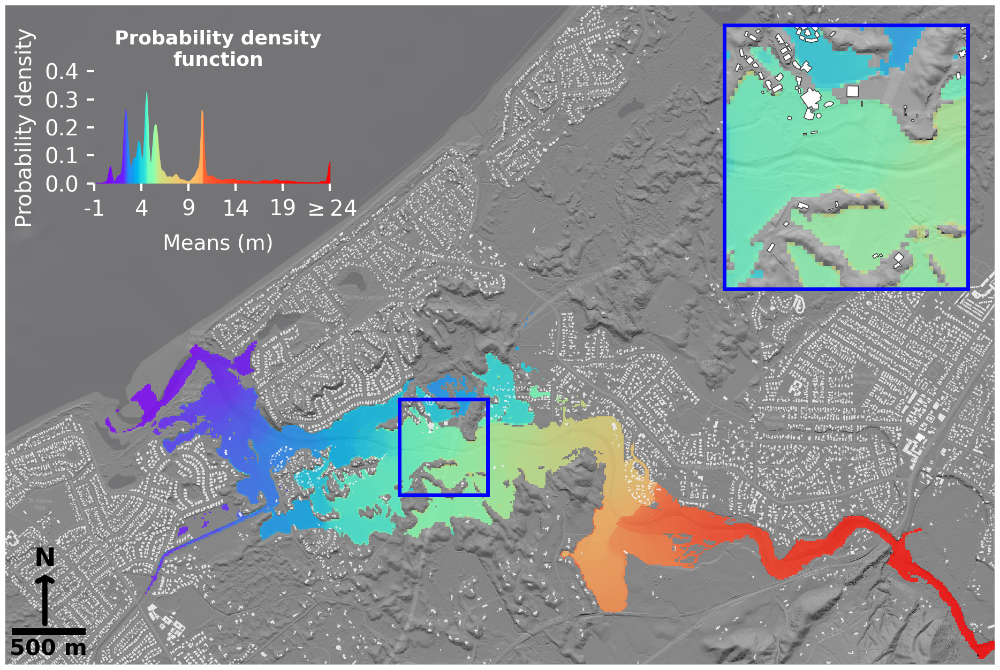

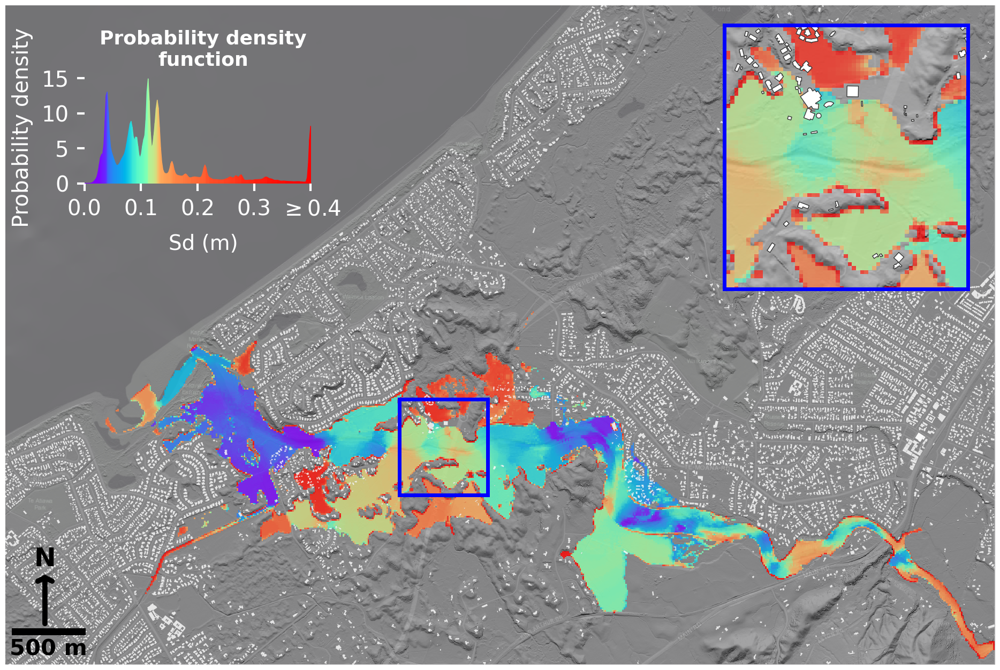

CPU times: total: 1min 31s
Wall time: 1min 31s


In [10]:
%%time
map_plotting_wse(
    ['mean', 'sd'],
    building_data,
    terrain_data,
    extract_wse
)

##### 4.5. Buildings and Areas plotting

In [ ]:
# area_building_plotting(
#     (10, 7),
#     statistic_dict_wse['area'],
#     [0.7, 0.95],
#     'area'
# )

In [ ]:
# area_building_plotting(
#     (10, 7),
#     statistic_dict_wse['building'],
#     [0.7, 0.95],
#     'building'
# )

---------------------------------------------------------------------------------------------------------------------------

## WATER DEPTH

##### 5.1. CSV generation

In [4]:
# If csv file was generated, use the code below to direct to the folder storing that csv file
df_wd = pd.read_csv(fr"S:\\for\\GRID\\versions\\vers001\\5_analysis\\wd\\untransformed_csv\\all_simulations.csv")

##### 5.2. Impact calculation

In [ ]:
# %%time
# water_raster_nobackground(df_wd, flood_rate, extract_wd)

In [ ]:
# %%time
# watermap_onepolygon_parallelism(df_wd, flood_rate, 30, extract_wd)

##### 5.3. Variation calculation

In [5]:
%%time
statistic_dict_wd = calculation_dict(
    df_wd, resolution,
    building_path,
    flood_rate,
    extract_wd, -9999,
    True
)

CPU times: total: 31.8 s
Wall time: 36.4 s


##### 5.4. Map plotting

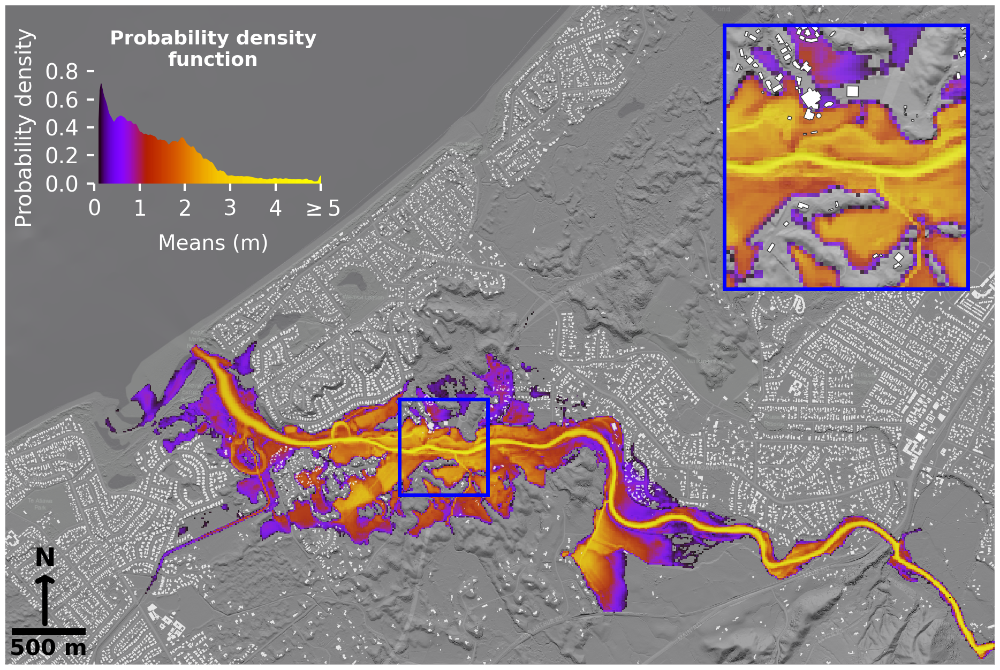

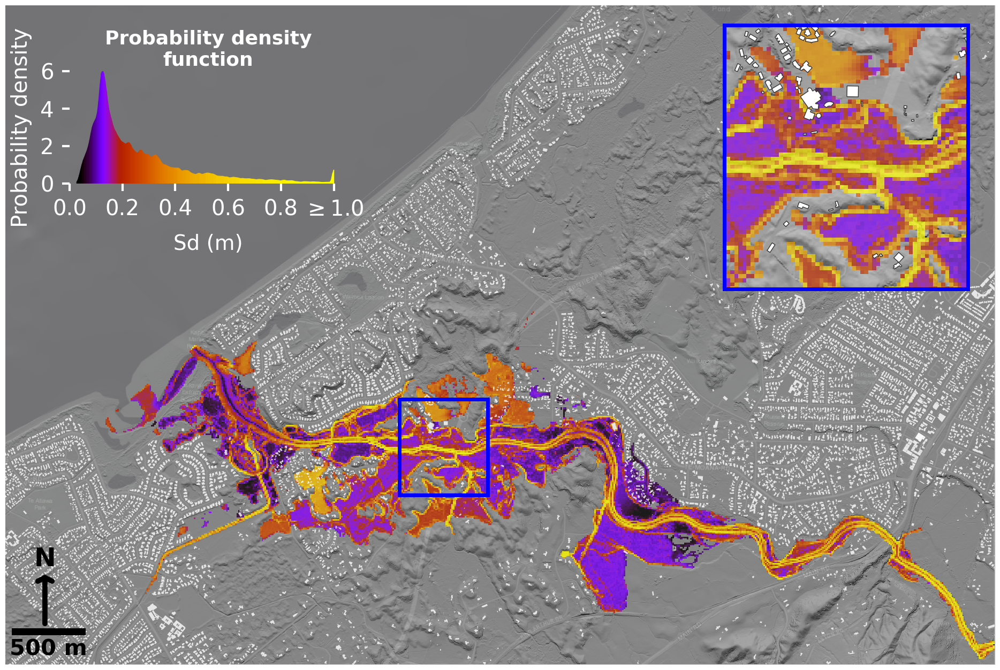

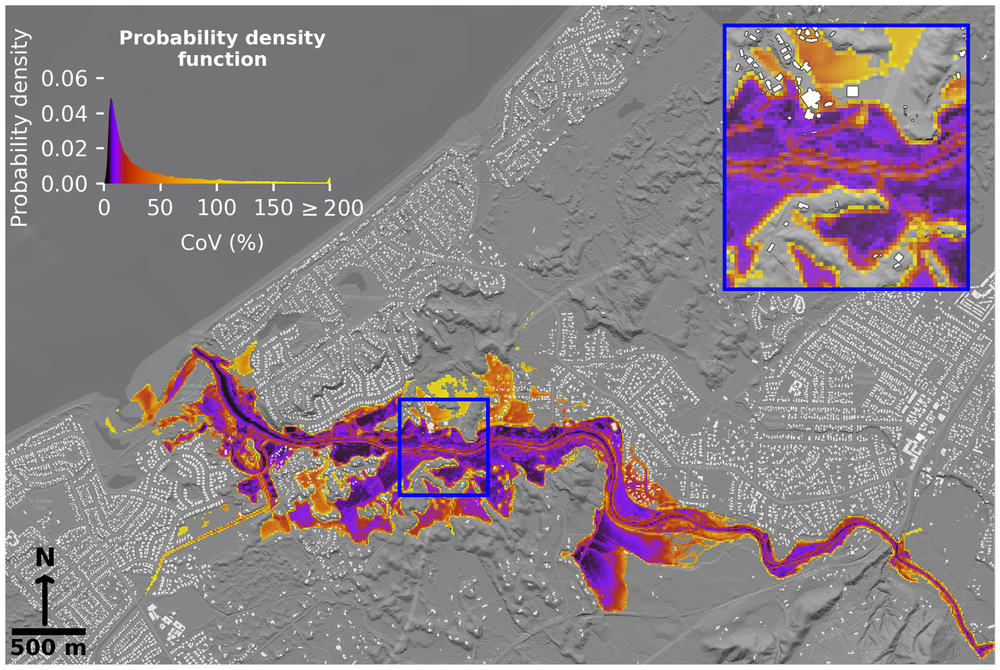

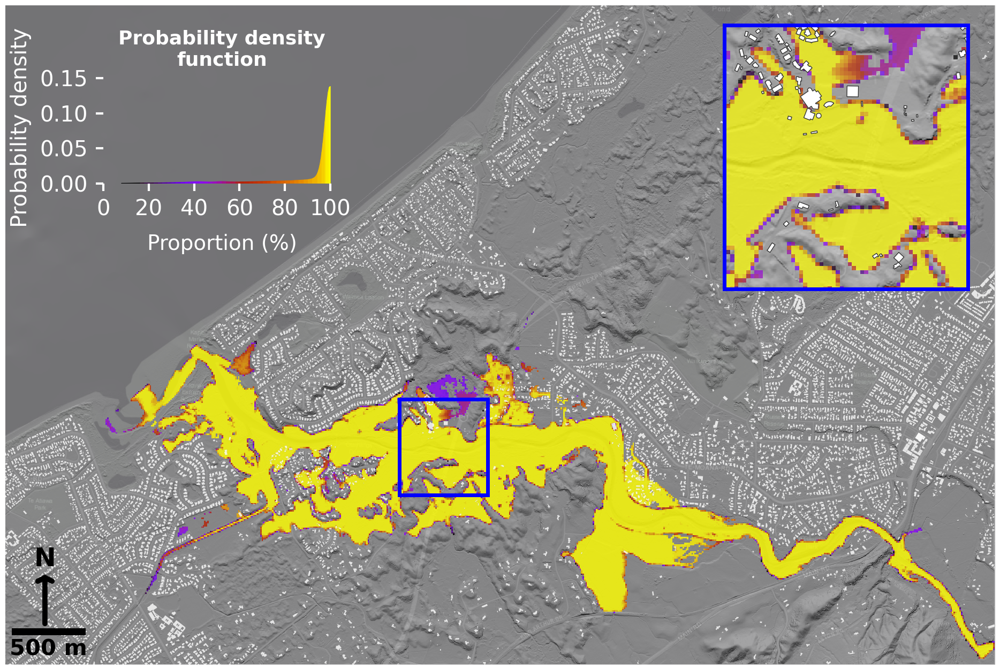

CPU times: total: 3min 4s
Wall time: 3min 6s


In [8]:
%%time
map_plotting_wd(
    ['mean', 'sd', 'cv', 'cell'],
    building_data,
    terrain_data,
    extract_wd
)

##### 5.5. Buildings and Areas plotting

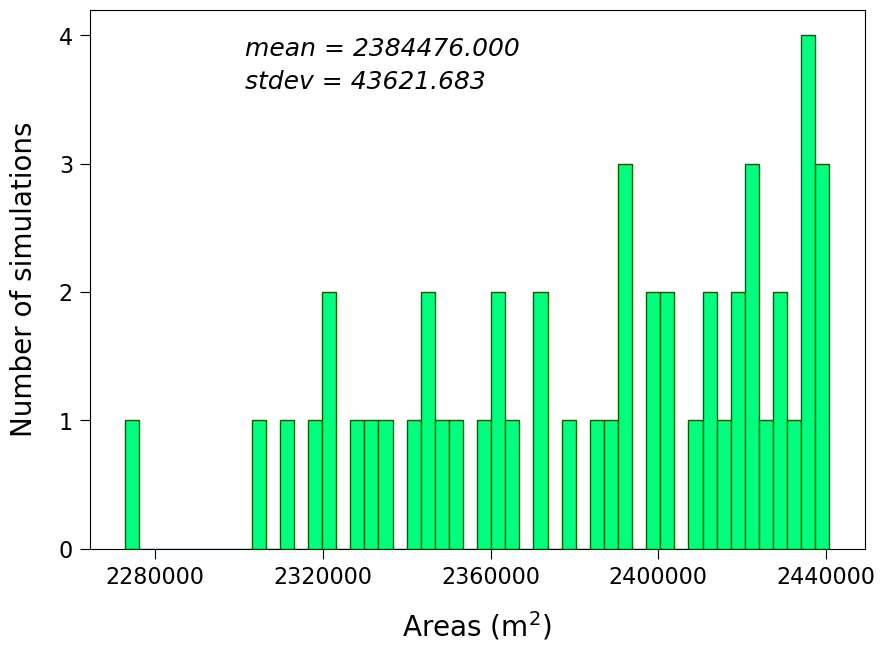

In [7]:
area_plotting_only(
    (10, 7),
    statistic_dict_wd['area'],
    [0.2, 0.95],
    'area'
)

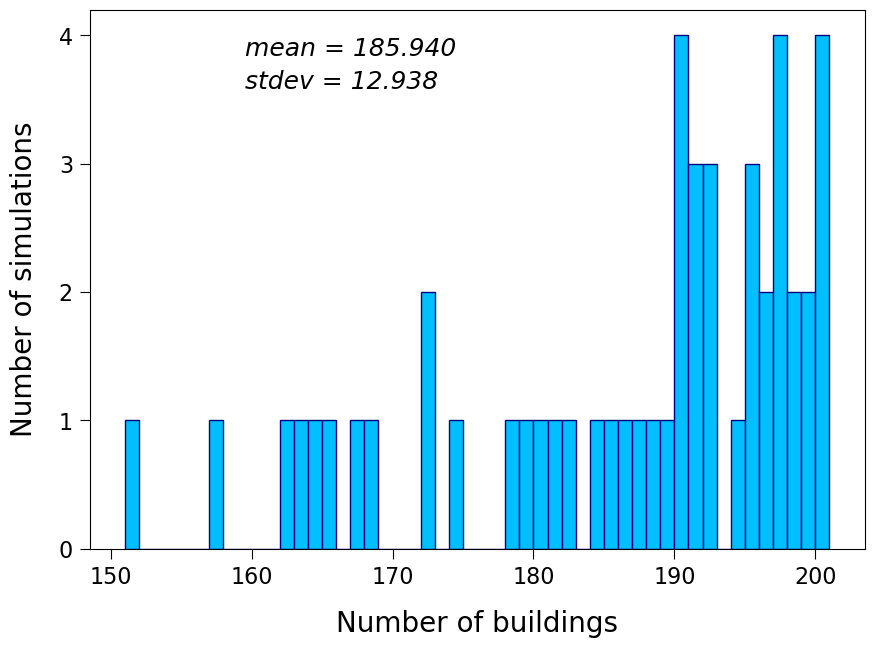

In [6]:
building_plotting_only(
    (10, 7),
    statistic_dict_wd['building'],
    [0.2, 0.95],
    'building'
)